In [79]:
import os

import pandas as pd
import geopandas as gpd
from shapely.ops import unary_union
import folium

import branca.colormap as cm

import numpy as np
import matplotlib.pyplot as plt

import itertools


In [41]:
# 1. Read CSV - get relevant columns only
csv_fn = 'lidar_metadata_full.csv'
df = pd.read_csv(csv_fn)

# If your CSV has a header/first line, no need for adjustments. 
# We'll keep only filename and the ground density
df['filename_short'] = df['file'].apply(lambda x: os.path.splitext(os.path.basename(str(x)))[0])

print(df['filename_short'].head())

df_density = df[['filename_short', 'density_ground_per_m2']]

0    JAM_A02_2011_laz_4
1    JAM_A02_2011_laz_5
2    JAM_A02_2011_laz_7
3    JAM_A02_2011_laz_6
4    JAM_A02_2011_laz_2
Name: filename_short, dtype: object


In [42]:
df_density.head()

,filename_short,density_ground_per_m2
0,JAM_A02_2011_laz_4,0.630129
1,JAM_A02_2011_laz_5,0.511132
2,JAM_A02_2011_laz_7,0.466583
3,JAM_A02_2011_laz_6,0.428028
4,JAM_A02_2011_laz_2,0.429171


In [57]:
# 2. Load GeoPackage with tile extents. 
# Let's assume the gpkg has a column called 'filename' or similar that matches lidar files
gpkg_fn = 'lidar_extents.gpkg'
gdf = gpd.read_file(gpkg_fn)

# If needed, adjust the filename/key column for merging:
if 'filename' not in gdf.columns:
    print(gdf.columns)  # Find the correct column

# 3. Get just the filename (strip folder paths)
def get_short_filename(s):
    if isinstance(s, str):
        return s.split('/')[-1]
    return s

gdf['filename_short'] = gdf['filename'].apply(get_short_filename)

# 4. Remove the last underscore-separated part from 'filename_short'
def strip_last_underscore_part(s):
    if isinstance(s, str):
        parts = s.split('_')
        # Only strip if more than one part
        if len(parts) > 1:
            return '_'.join(parts[:-1])
        else:
            return s
    return s

gdf['filename_short'] = gdf['filename_short'].apply(strip_last_underscore_part)

# Preview the change:
print(gdf[['filename', 'filename_short']].head())

                         filename       filename_short
0   ANA_A01_2017_laz_0_fnands.tif   ANA_A01_2017_laz_0
1  ANA_A01_2017_laz_10_fnands.tif  ANA_A01_2017_laz_10
2  ANA_A01_2017_laz_11_fnands.tif  ANA_A01_2017_laz_11
3  ANA_A01_2017_laz_12_fnands.tif  ANA_A01_2017_laz_12
4   ANA_A01_2017_laz_1_fnands.tif   ANA_A01_2017_laz_1


In [58]:
gdf.head()

,filename,geometry,filename_short
0,ANA_A01_2017_laz_0_fnands.tif,"POLYGON ((-55.00193 -3.36349, -55.00193 -3.372...",ANA_A01_2017_laz_0
1,ANA_A01_2017_laz_10_fnands.tif,"POLYGON ((-55.00189 -3.38157, -55.00189 -3.381...",ANA_A01_2017_laz_10
2,ANA_A01_2017_laz_11_fnands.tif,"POLYGON ((-55.0101 -3.36351, -55.0101 -3.37256...",ANA_A01_2017_laz_11
3,ANA_A01_2017_laz_12_fnands.tif,"POLYGON ((-54.99291 -3.37252, -54.99291 -3.381...",ANA_A01_2017_laz_12
4,ANA_A01_2017_laz_1_fnands.tif,"POLYGON ((-55.01009 -3.34768, -55.01009 -3.354...",ANA_A01_2017_laz_1


In [59]:
# 3. Merge on filename_short  
gdf = gdf.merge(df_density, on='filename_short', how='left')

# Rename for clarity
gdf = gdf.rename(columns={'density_ground_per_m2':'ground_density'})

In [61]:
# 4. Save single-tile density GeoPackage
gdf_out_fn = 'lidar_density_tiles.gpkg'
gdf.to_file(gdf_out_fn, driver='GPKG')
print(f"Saved individual tile ground density to {gdf_out_fn}")

Saved individual tile ground density to lidar_density_tiles.gpkg


In [62]:
# STOP HERE if you only want per-tile density.
# For combined density in overlapping regions, continue...

# 5. Dissolve into overlapping polygons, summing density

# Approach: For all overlaps, sum densities.

tiles = []
for idx, row in gdf.iterrows():
    tiles.append({'geometry': row.geometry, 
                  'ground_density': row.ground_density, 
                  'filename': row.filename_short})

gdf_tiles = gpd.GeoDataFrame(tiles, crs=gdf.crs)

# We union all tiles (keep multi-geometries!) and explode
union = unary_union(gdf_tiles.geometry)
gdf_union = gpd.GeoDataFrame(geometry=[union], crs=gdf.crs).explode(index_parts=True).reset_index(drop=True)

# Now, for each polygon, find which original tiles overlap it, sum their ground_density
def sum_density(poly):
    overlapping = gdf_tiles[gdf_tiles.geometry.intersects(poly)]
    # sum the densities of all overlapping tiles
    return overlapping.ground_density.sum()

gdf_union['combined_ground_density'] = gdf_union.geometry.apply(sum_density)

# Save unioned polygon GeoPackage
gdf_union_out_fn = 'lidar_density_overlapping.gpkg'
gdf_union.to_file(gdf_union_out_fn, driver='GPKG')
print(f"Saved overlapping/combined ground density to {gdf_union_out_fn}")

# Now you can plot `lidar_density_overlapping.gpkg` in Folium or QGIS and color by 'combined_ground_density'

Saved overlapping/combined ground density to lidar_density_overlapping.gpkg


In [68]:
gdf = gpd.read_file('lidar_density_tiles.gpkg')

gdf['ground_density'] = gdf['ground_density'].fillna(0)
# gdf = gdf.dropna(subset=['ground_density'])

# --------- Specify location of interest by filename (without extension) ---------
location_filename = "RIB_A01_2014_laz_2"  # <-- change this to your filename of interest
filename_col = 'filename_short' if 'filename_short' in gdf.columns else 'filename'

# Get the geometry for that tile
center_tile = gdf[gdf[filename_col] == location_filename]
if not center_tile.empty:
    centroid = center_tile.geometry.iloc[0].centroid
    center = [centroid.y, centroid.x]
else:
    # Fallback: mean of all centroids
    center = [gdf.geometry.centroid.y.mean(), gdf.geometry.centroid.x.mean()]
    print(f"Warning: tile '{location_filename}' not found, using overall centroid.")

# -------- Create folium map centered on selected tile -----------
m = folium.Map(location=center, zoom_start=13, tiles="cartodbpositron")

In [78]:
# --------- Specify threshold range ---------
min_threshold = 0.0  # set to your desired min value
max_threshold = 200.0  # set to your desired max value

# Filter to ground_density in the specified range
gdf_filtered = gdf[(gdf['ground_density'] > min_threshold) & (gdf['ground_density'] < max_threshold)].copy()

# Update the colormap so it matches the filtered range
if not gdf_filtered.empty:
    min_density = gdf_filtered['ground_density'].min()
    max_density = gdf_filtered['ground_density'].max()
else:
    min_density = min_threshold
    max_density = max_threshold

import branca.colormap as cm
colormap = cm.linear.YlOrRd_09.scale(min_density, max_density)
colormap.caption = 'Ground Point Density (per m²)'

def style_function(feature):
    val = feature['properties']['ground_density']
    return {
        'fillColor': colormap(val),
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0.7,
    }

print(f"Number of tiles displayed: {len(gdf_filtered)}")

folium.GeoJson(
    gdf_filtered,
    style_function=style_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=[filename_col, 'ground_density'],
        aliases=['Tile', 'Density (/m²)'],
        localize=True
    )
).add_to(m)

colormap.add_to(m)
m

Number of tiles displayed: 3105


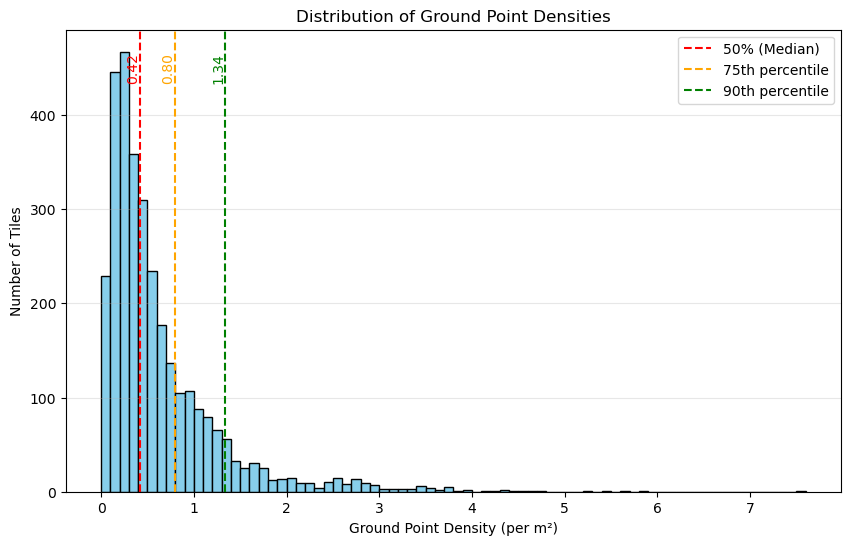

In [76]:
# Compute percentiles
median = np.percentile(gdf['ground_density'], 50)
p75 = np.percentile(gdf['ground_density'], 75)
p90 = np.percentile(gdf['ground_density'], 90)

# For bins, start at 0 or min, step 0.1
dens_min = gdf['ground_density'].min()
dens_max = gdf['ground_density'].max()
bins = np.arange(0, dens_max + 0.1, 0.1)

plt.figure(figsize=(10,6))
plt.hist(gdf['ground_density'], bins=bins, color='skyblue', edgecolor='black')
plt.xlabel('Ground Point Density (per m²)')
plt.ylabel('Number of Tiles')
plt.title('Distribution of Ground Point Densities')
plt.grid(axis='y', alpha=0.3)

# Plot vertical lines for percentiles
plt.axvline(median, color='red', linestyle='--', label='50% (Median)')
plt.axvline(p75, color='orange', linestyle='--', label='75th percentile')
plt.axvline(p90, color='green', linestyle='--', label='90th percentile')

# Annotate the lines
plt.text(median, plt.ylim()[1]*0.95, f'{median:.2f}', color='red', rotation=90, ha='right', va='top')
plt.text(p75, plt.ylim()[1]*0.95, f'{p75:.2f}', color='orange', rotation=90, ha='right', va='top')
plt.text(p90, plt.ylim()[1]*0.95, f'{p90:.2f}', color='green', rotation=90, ha='right', va='top')

plt.legend()
plt.show()

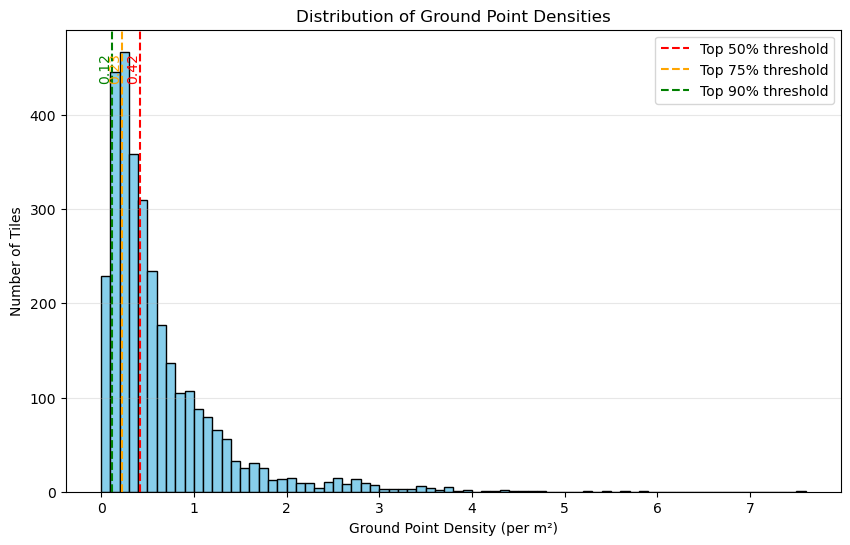

In [77]:
# Compute quantiles "from the top"
q50 = np.percentile(gdf['ground_density'], 50)  # divides 50/50 (median)
q25 = np.percentile(gdf['ground_density'], 25)  # 25% below, 75% above
q10 = np.percentile(gdf['ground_density'], 10)  # 10% below, 90% above

# Bins as before
dens_min = gdf['ground_density'].min()
dens_max = gdf['ground_density'].max()
bins = np.arange(0, dens_max + 0.1, 0.1)

plt.figure(figsize=(10,6))
plt.hist(gdf['ground_density'], bins=bins, color='skyblue', edgecolor='black')
plt.xlabel('Ground Point Density (per m²)')
plt.ylabel('Number of Tiles')
plt.title('Distribution of Ground Point Densities')
plt.grid(axis='y', alpha=0.3)

# Plot vertical lines for top X%
plt.axvline(q50, color='red', linestyle='--', label='Top 50% threshold')
plt.axvline(q25, color='orange', linestyle='--', label='Top 75% threshold')
plt.axvline(q10, color='green', linestyle='--', label='Top 90% threshold')

# Annotate the lines
plt.text(q50, plt.ylim()[1]*0.95, f'{q50:.2f}', color='red', rotation=90, ha='right', va='top')
plt.text(q25, plt.ylim()[1]*0.95, f'{q25:.2f}', color='orange', rotation=90, ha='right', va='top')
plt.text(q10, plt.ylim()[1]*0.95, f'{q10:.2f}', color='green', rotation=90, ha='right', va='top')

plt.legend()
plt.show()

In [ ]:
# 1. Create an overlay of all intersecting regions
regions = []

for idx1, row1 in gdf.iterrows():
    overlap_tiles = [(row1['filename_short'], row1.geometry, row1['ground_density'])]
    for idx2, row2 in gdf.iterrows():
        if idx2 <= idx1:
            continue  # skip self & lower triangle
        if row1.geometry.intersects(row2.geometry):
            inter = row1.geometry.intersection(row2.geometry)
            if not inter.is_empty:
                overlap_tiles.append((row2['filename_short'], inter, row2['ground_density']))
    
    # For each unique intersection region, get the sum, the multiplier, and the geometry
    # This simple approach only finds pairwise overlaps - for complex >2 overlaps, use a dissolve/overlay
    for t in overlap_tiles:
        regions.append({
            'geometry': t[1],
            'sum_ground_density': t[2],   # For true overlap, you'll want to sum ground_density for all overlaps (see below!)
            'n_overlapping_tiles': len(overlap_tiles)  # If more tiles are overlapped, this becomes >1
        })

# A better way is to use geopandas.overlay (which creates all unique regions and unioned attributes)
# Let's do that:

out_gdf = gdf.copy()
out_gdf['ones'] = 1  # helper for counting overlaps

# In geopandas 0.7.0+, use gpd.overlay with 'union' and then spatial join + groupby
import warnings
warnings.filterwarnings('ignore')

# Create overlay: all unique geometry regions
overlap_gdf = gpd.overlay(out_gdf, out_gdf, how='union')

# For each region, count how many input polygons touch it (multiplier) and sum their densities
result = gpd.GeoDataFrame(geometry=overlap_gdf.geometry)
# For speed, you can do a spatial join:
join = gpd.sjoin(result, gdf[['geometry', 'ground_density']], predicate='intersects')

KeyError: 'index_left'

In [82]:
density_sum = join.groupby(join.index)['ground_density'].sum()
overlap_count = join.groupby(join.index).size()

result['sum_ground_density'] = result.index.map(density_sum)
result['n_overlapping_tiles'] = result.index.map(overlap_count)

# Save as a new GeoPackage
result = result.drop_duplicates(subset='geometry')
result = result.loc[result.geometry.area > 0] # drop empty
result.to_file('lidar_density_sum_and_multiplier.gpkg', driver='GPKG')

print("GeoPackage 'lidar_density_sum_and_multiplier.gpkg' written: attributes are sum_ground_density and n_overlapping_tiles")

GeoPackage 'lidar_density_sum_and_multiplier.gpkg' written: attributes are sum_ground_density and n_overlapping_tiles


In [83]:
# Load the unioned layer
gdf_regions = gpd.read_file('lidar_density_sum_and_multiplier.gpkg')

# Optional: Remove empty or very small geometries
gdf_regions = gdf_regions[gdf_regions.geometry.area > 0]

# Center the map (use mean centroid of remaining polygons)
center = [
    gdf_regions.geometry.centroid.y.mean(),
    gdf_regions.geometry.centroid.x.mean()
]

m = folium.Map(location=center, zoom_start=13, tiles="cartodbpositron")

# Colormap for the sum of ground densities
min_density = gdf_regions['sum_ground_density'].min()
max_density = gdf_regions['sum_ground_density'].max()
colormap = cm.linear.YlOrRd_09.scale(min_density, max_density)
colormap.caption = 'Sum of Ground Point Density (per m²)'

def style_function(feature):
    val = feature['properties']['sum_ground_density']
    if val is None:
        color = '#888888'
    else:
        color = colormap(val)
    return {
        'fillColor': color,
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0.7,
    }

# Add the GeoJson layer
folium.GeoJson(
    gdf_regions,
    style_function=style_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['sum_ground_density', 'n_overlapping_tiles'],
        aliases=['Sum Ground Density (/m²)', 'Num Overlapping Tiles'],
        localize=True
    )
).add_to(m)

colormap.add_to(m)
m

In [85]:
gdf_regions

,sum_ground_density,n_overlapping_tiles,geometry
0,1.181048,7,"POLYGON ((-55.00193 -3.36349, -54.99291 -3.363..."
1,0.702181,4,"POLYGON ((-55.00193 -3.37255, -55.00193 -3.363..."
2,0.695103,4,"POLYGON ((-54.99291 -3.37255, -55.00191 -3.372..."
3,0.671792,4,"POLYGON ((-54.99291 -3.36349, -54.99291 -3.364..."
4,0.856955,5,"POLYGON ((-55.00193 -3.36349, -54.99367 -3.363..."
...,...,...,...
17373,0.261128,4,"POLYGON ((-54.95152 -3.05466, -54.95152 -3.054..."
17374,0.251750,4,"POLYGON ((-54.94453 -3.05256, -54.94453 -3.046..."
17375,0.251750,4,"POLYGON ((-54.94453 -3.0456, -54.94106 -3.0456..."
17376,0.261128,4,"POLYGON ((-54.95152 -3.05466, -54.9505 -3.0546..."


In [84]:
# Load the unioned layer
gdf_regions = gpd.read_file('lidar_density_sum_and_multiplier.gpkg')

# Optional: Remove empty or very small geometries
gdf_regions = gdf_regions[gdf_regions.geometry.area > 0]

# Center the map (use mean centroid of remaining polygons)
center = [
    gdf_regions.geometry.centroid.y.mean(),
    gdf_regions.geometry.centroid.x.mean()
]

m = folium.Map(location=center, zoom_start=13, tiles="cartodbpositron")

# Colormap for the sum of ground densities
min_density = gdf_regions['sum_ground_density'].min()
max_density = gdf_regions['sum_ground_density'].max()
colormap = cm.linear.YlOrRd_09.scale(min_density, max_density)
colormap.caption = 'Sum of Ground Point Density (per m²)'

def style_function(feature):
    val = feature['properties']['sum_ground_density']
    if val is None:
        color = '#888888'
    else:
        color = colormap(val)
    return {
        'fillColor': color,
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0.7,
    }

# Add the GeoJson layer
folium.GeoJson(
    gdf_regions,
    style_function=style_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['sum_ground_density', 'n_overlapping_tiles'],
        aliases=['Sum Ground Density (/m²)', 'Num Overlapping Tiles'],
        localize=True
    )
).add_to(m)

colormap.add_to(m)
m